# House Price Prediction

## 1. Defining the Question

### a) Specifying the Question
Working as a data scientist for Hass Consulting Company, my task is to study the factors that affect housing prices using the given information on real estate properties that was collected over the past few months. I am also tasked with creating a model that would allow the company to accurately predict the sale of prices upon being provided with the predictor variables. 

### b) Defining the Metric for Success
i. Provide insight on the data set through exploratory data analysis.

ii. Create a multiple regression models to predict the price of houses based on the available information. The models include:
  a. Multiple Linear Regression Model

  b. Ridge Regression Model

  c. Lasso Regression Model

  d. Elastic Net Regression Model
  
  e. Quantile Regression Model

### c) Understanding the context

The Kenyan real estate market has grown steadily over the years with the sector being an established contributor to the country’s GDP. According to a report by Cytonn Investments, the contribution of the real estate sector to the GDP has grown from 10.5% in 2000 to 13.8% in 2016. One of the key drivers of this growth have been infrastructural developments such as improved roads and enhanced utility connections. Another driver of this growth has been a stable GDP growth of 5.4% which is higher than the regions average of 4.1%. Although real estate encompasses multiple business components, the residential sector has largely benefited from a population growth rate averaging 2.6 P.A. which has led to an substantial increased demand.

Hass Consulting Company has been in the Kenyan market for nearly 25 years with some of its services including property sales and letting, asset valuation, property and facilities management, property market research development concept and design alignment, joint venture and financing structure, and development marketing and sales. For each of the services, it is paramount that Hass Consulting has a strong understanding of the real estate market to ensure customer satisfaction along with project success and profitability. With regards to profitability, Hass Consulting develops predictive models that ensure that their product prices are competitive while still ensuring that they make profit.

### d) Recording the Experimental Design
*   To predict the house prices, I will develop 5 regression models namely: multiple linear, ridge, lasso, and elastic net regressions.
*   I will develop a quantile regression model to examine the impact of the different variables on the prices of houses for the 'cheap' and 'expensive' houses.
*   To evaluate model performance, I will split the data set into train and test data.
*   To improve model performance, I will perform hyperparameter tuning and grid search.
*   I will also perform feature engineering to improve model performance. 

### e) Data Relevance
The relevance of this data set is highlighted by the features used to predict the price of a house. From a quick internet search, some of the features identifed in the data set were mentioned as key factors when choosing a new home/ house.

In [1]:
#Importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
import pandas_profiling
sb.set_style()
import warnings
warnings.filterwarnings("ignore")

## 2. Loading and previewing the data set

In [3]:
# previewing top of housing results data set
housing = pd.read_csv('/home/practitioner/Downloads/house_data.csv')
housing.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [4]:
# preview last five rows
housing.tail()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
21608,263000018,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287
21612,1523300157,325000.0,2,0.75,1020,1076,2.0,0,0,3,7,1020,0,2008,0,98144,47.5941,-122.299,1020,1357


In [5]:
# checking the shape of our datasets
print('Housing data set rows & columns:', housing.shape)

Housing data set rows & columns: (21613, 20)


The data set has 21,613 rows and 20 columns

In [6]:
# checking the data types
housing.dtypes

id                 int64
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object

A quick overview of the data set indicates that the table has 21,613 rows and 20 columns. All the columns in the data set have a numerical data type although the house ID, and the ZipCode hold categorical information.

## 3. External Data Source Validation
I validated the quality of the data set using an internet search where I discovered that the data set was collected by King County, Washington. A link to the data set can be found here

## 4. Tidying the Dataset

In [7]:
# checking for null values in the results dataset
housing.isna().sum()

id               0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

There are no null values in the dataset

In [8]:
# checking duplicates
print(housing.duplicated().sum(), 'duplicates in the data set')
# removing duplciates
housing = housing.drop_duplicates()
# checking duplicates
print(housing.duplicated().sum(), 'duplicates in the data set')

3 duplicates in the data set
0 duplicates in the data set


The data set had only 3 duplicates which were effectively removed.

In [9]:
# checking anomalies
print(housing['bathrooms'].unique())

housing['bathrooms'] = round(housing['bathrooms'])

print(housing['bathrooms'].unique())

[1.   2.25 3.   2.   4.5  1.5  2.5  1.75 2.75 3.25 4.   3.5  0.75 4.75
 5.   4.25 3.75 0.   1.25 5.25 6.   0.5  5.5  6.75 5.75 8.   7.5  7.75
 6.25 6.5 ]
[1. 2. 3. 4. 5. 0. 6. 7. 8.]


The data set had bathrooms with continuous numbers which makes no sense. To fix this, I rounded off the number of bedrooms.

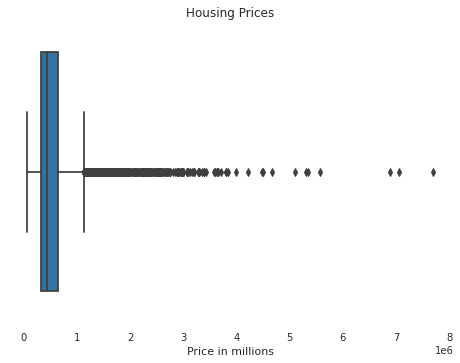

In [10]:
# checking outliers
sb.boxplot(x=housing['price'])
plt.xlabel('Price in millions')
plt.title('Housing Prices')
plt.show()

In [11]:
# check descriptions for better understanding of house prices
housing.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161000e+04,2.161000e+04,21610.000000,21610.000000,21610.000000,2.161000e+04,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000,21610.000000
mean,4.580161e+09,5.401789e+05,3.370847,2.058723,2079.881212,1.510829e+04,1.494239,0.007543,0.234197,3.409440,7.656779,1788.347894,291.533318,1971.003609,84.322351,98077.945673,47.560049,-122.213910,1986.518695,12769.031976
std,2.876547e+09,3.673876e+05,0.930110,0.755576,918.500299,4.142323e+04,0.539994,0.086523,0.766136,0.650764,1.175500,828.138723,442.596699,29.372639,401.499264,53.505373,0.138572,0.140833,685.425781,27305.972464
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.216125e+05,3.000000,2.000000,1425.500000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.470925,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.000000,1910.000000,7.619000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.231000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.000000,2550.000000,1.068875e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000



By plotting a boxplot for the prices, we can see that there multiple outliers. The price at the 75th percentile is 645,000 while the highest price is 7,700,000 which is a very large difference.

In [12]:
#compute IQR to remove price outliers
q1_diff, q3_diff = np.percentile(housing['price'], [25, 75])
iqr_diff = q3_diff - q1_diff

lower_diff = q1_diff - (1.5 * iqr_diff)
upper_diff = q3_diff + (1.5 * iqr_diff)
housing_1 = housing.drop(housing[housing['price'] > upper_diff].index)
housing_no_outliers = housing_1.reset_index(drop=True)
print(housing.shape)
print(housing_no_outliers.shape)

(21610, 20)
(20471, 20)


All outliers in price were removed. I did not remove outliers from other variable columns since if they had no significant on the price, then it is likely that the variable represents something unique about the house.

## 5. Exporatory Data Analysis

In [13]:
# creating a profile report for the data set
from pandas_profiling import ProfileReport
profile = ProfileReport(housing_no_outliers, title='Housing Profile Report')

In [14]:
report = profile.to_notebook_iframe()
report

In [15]:
# save profile repot as html file
profile.to_file("Housing Profile Report.html")

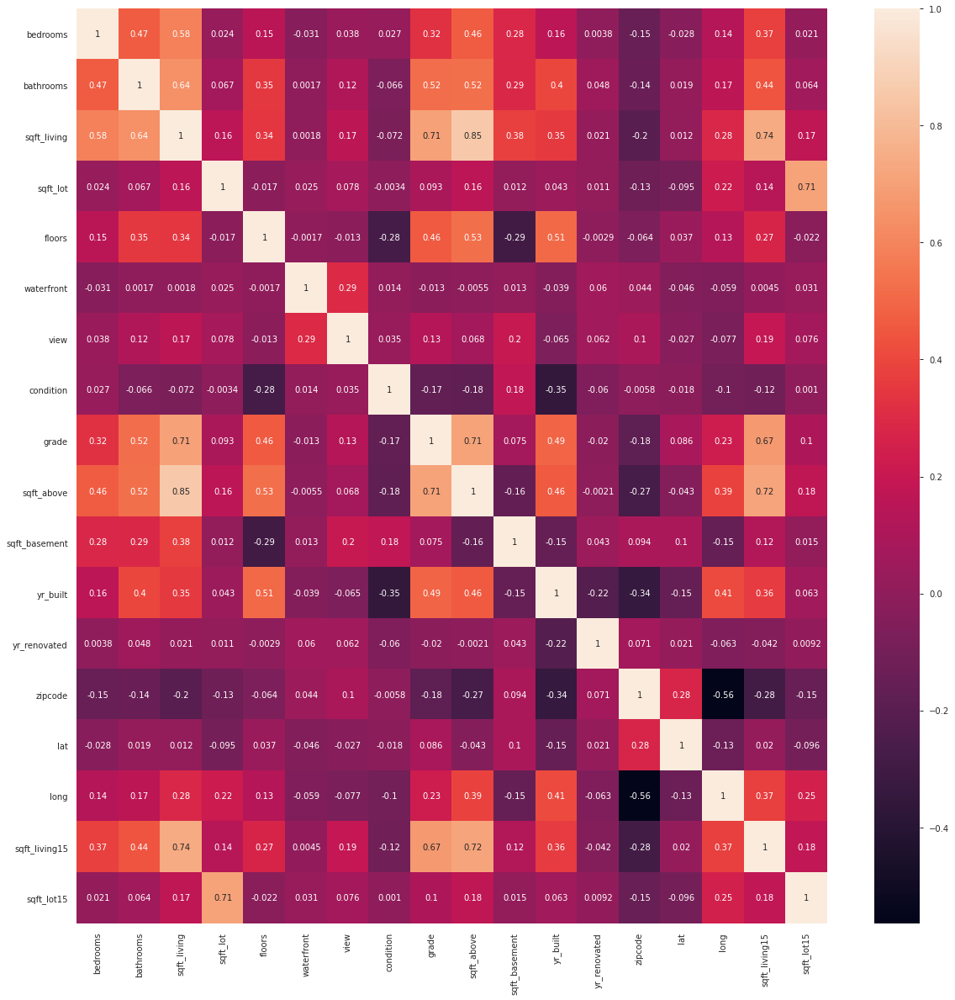

In [16]:
# Check of correlation between features
plt.figure(figsize=(20,20))
sb.heatmap(housing_no_outliers.drop(['price', 'id'], 1).corr(), annot=True)
plt.show()

### Univariate Analysis
The data set has 18 features, 1 target, and 1 index column

In the data set with price outliers, the minimum price of a house is 75,000 while the maximum price is 1,090,000. The standard deviation in the price of houses is 208,759 and the average price of a house is 477,217.

Out of the sampled houses, the least number of bedrooms recorded was zero while the highest was 33. A histogram of the prices shows a positive skewness while a kurtosis of 55.78 indicates a leptokurtic distribution where the distribution's tails are heavy. This distribution is imitated by multiple variables including 'bathrooms', 'sqft_living', 'sqft_lot', 'view', 'sqft_above' , 'sqft_basement', 'yr_renovated', 'long', and 'sqft_lot15'. Some features have a normal or near normal distribution  which include 'condition', 'grade', and 'sqft_living'. Using an example of the 'grade', the minimum value a house can have is 1(low) while the highest is 12(high) indicating the quality of the house. This variable follows a normal distribution with a skewness of 0.49 and a kurtosis of 0.82 indicating a mesokurtic distribution.

Two columns followed a bimodal distribution i.e. 'floors' and 'zipcode' indicating that different stratas could have been used. With regards to the waterfront, nearly 99% of the houses sampled do not have a waterfront. 

### Bivariate and Multivariate Analysis
I used the correlation coeeficients to explore the relationship between the different variables and the target as well as between the variables. Plotted against price, 'sqft_living', 'sqft_living15', and 'grade' had the highest correlations. However, while looking at the correlations of the features against each other, several columns appear to be correlated which I will need to resolve before building the regression model.

## 6. Modelling

In [17]:
#checking multicolinearity using VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

variables = housing_no_outliers.drop(['id', 'price'], 1)
X = add_constant(variables)
pd.Series([variance_inflation_factor(X.values, i) 
               for i in range(X.shape[1])], 
              index=X.columns)

const            4.594869e+06
bedrooms         1.650378e+00
bathrooms        2.012759e+00
sqft_living               inf
sqft_lot         2.049029e+00
floors           1.952339e+00
waterfront       1.106808e+00
view             1.237299e+00
condition        1.242480e+00
grade            2.835420e+00
sqft_above                inf
sqft_basement             inf
yr_built         2.349691e+00
yr_renovated     1.127379e+00
zipcode          1.660441e+00
lat              1.189489e+00
long             1.844444e+00
sqft_living15    2.832917e+00
sqft_lot15       2.085651e+00
dtype: float64

A variance infaltion factor of inf indicates perfect multicolinearity, meaning we should remove these features from the model. Ideally, a vif of between 0 and 5 is acceptable. Consequently, 'sqft_above', 'sqft_living', and 'sqft_living15' will not be used in the linear regression model.

### Multiple Linear Regression model

In [18]:
# import libraries for regression model
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

In [19]:
# assign the target and features
X = housing_no_outliers.drop(['id', 'price', 'sqft_above', 'sqft_living', 'sqft_living15'], 1)
y = housing_no_outliers['price']

For the features, we drop columns that had high multicolinearity along with the price and index columns.

In [20]:
# scaling the features
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

In [21]:
# splitting data into training and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_std, y, test_size=0.2, random_state=0)

I used a test size of 20% of the cleaned data set for testing and 80% for training.

In [22]:
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [23]:
# making Predictions
y_pred = regressor.predict(X_test)

In [24]:

# evaluating the algorithm
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 91328.1500198904
Mean Squared Error: 14359690369.449213
Root Mean Squared Error: 119831.92550171766


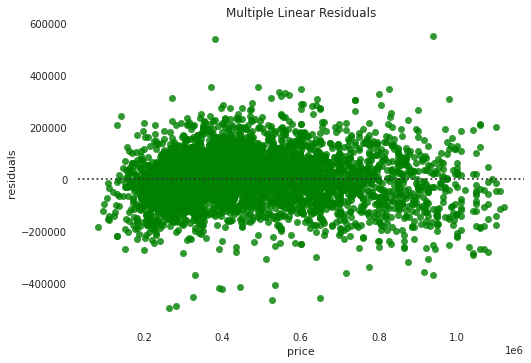

In [25]:
# plotting residuals
sb.residplot(y_test, y_pred, lowess=False, color="g", )
plt.xlabel('price')
plt.ylabel('residuals')
plt.title('Multiple Linear Residuals')
plt.show()

In [26]:
# check model score
regressor.score(X_test, y_test)

0.6628699051254685

My multiple linear regression model accuracy was 66% and had a mean squared error(MSE) of 14359690369.45.

In [27]:
# check model coefficients
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Multiple Linear Coefficient'])
coeff_df

,Multiple Linear Coefficient
bedrooms,10030.028205
bathrooms,24970.591078
sqft_lot,9251.783927
floors,28039.744899
waterfront,7414.588505
view,24673.699785
condition,14844.506783
grade,117910.371708
sqft_basement,17493.303184
yr_built,-57610.683077


### Ridge Regression

In [28]:
# assign the target and features
X = housing_no_outliers.drop(['id', 'price', 'sqft_above', 'sqft_living', 'sqft_living15'], 1)
y = housing_no_outliers['price']

For the features, we drop columns that had high multicolinearity along with the price and index columns.

In [29]:
# scaling the features
scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

In [30]:
# Dividing our data into training and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_std, y, test_size=0.2, random_state=0)

In [31]:
# find best params for ridge using GridSearch
ridge = Ridge(normalize=True)
search = GridSearchCV(estimator=ridge,param_grid={'alpha':np.logspace(-10,2,13)},scoring='neg_mean_squared_error',n_jobs=1,refit=True,cv=10)

search.fit(X_train,y_train)
print('best parameters:', search.best_params_)

best parameters: {'alpha': 0.001}


Using grid search for hyper parameter tuning, an alpha of 0.001 was chosen for the L2 regularization.

In [32]:
# set best params and fit model
ridge = Ridge(normalize=True,alpha=0.001)
ridge.fit(X_train,y_train)
ridge_mse = (mean_squared_error(y_true=y_test,y_pred=ridge.predict(X_test)))
print('Mean Squared Error:', ridge_mse)
print('Ridge score:', ridge.score(X_test,y_test))

Mean Squared Error: 14357789580.049803
Ridge score: 0.6629145309700426


My ridge regression model accuracy was 66% and had a mean squared error(MSE) of 14357789580.05.

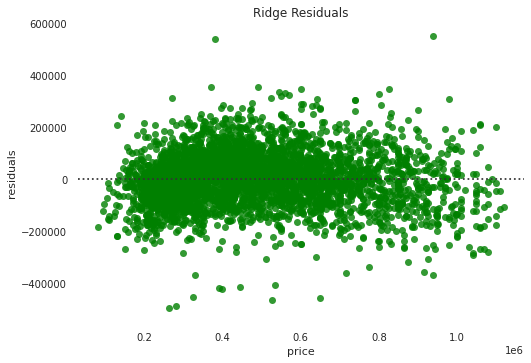

In [33]:
# plotting residuals
sb.residplot(y_test, y_pred, lowess=False, color="g", )
plt.xlabel('price')
plt.ylabel('residuals')
plt.title('Ridge Residuals')
plt.show()

In [34]:
# check model coefficients
coeff_df2 = pd.DataFrame(ridge.coef_, X.columns, columns=['Ridge Coefficient'])
coeff_df3 = pd.concat([coeff_df, coeff_df2], axis=1)
coeff_df3

,Multiple Linear Coefficient,Ridge Coefficient
bedrooms,10030.028205,10062.721656
bathrooms,24970.591078,24975.328679
sqft_lot,9251.783927,9247.629853
floors,28039.744899,28005.278458
waterfront,7414.588505,7404.066570
view,24673.699785,24675.475968
condition,14844.506783,14854.808762
grade,117910.371708,117720.757062
sqft_basement,17493.303184,17490.760577
yr_built,-57610.683077,-57422.785214


Since the features with high multicollinearity were already removed, the ridge the coefficients are almost similar.

### Lasso Regression

In [35]:
# importing packages for lasso regression
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler

In [36]:
# assign the target and features
X = housing_no_outliers.drop(['id', 'price', 'sqft_above', 'sqft_living', 'sqft_living15'], 1)
y = housing_no_outliers['price']

I again dropped columns with high multicolinearity.

In [37]:
# scale the features 
scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

In [38]:
# split the data into training and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_std, y, test_size=0.2, random_state=0)

In [39]:
# Define GridSearch parameters
from sklearn import linear_model

parameters = {'alpha': np.concatenate((np.arange(0.1,2,0.1), np.arange(2, 5, 0.5), np.arange(0, 250, 25)))}
lasso = linear_model.Lasso() 
gridlasso = GridSearchCV(lasso, parameters, scoring ='neg_mean_squared_error')
gridlasso.fit(X_train, y_train) 
gridlasso.best_params_

{'alpha': 175.0}

Using grid search for hyper parameter tuning, an alpha of 175 was chosen for the L1 regularization.

In [40]:
lasso = linear_model.Lasso(alpha=175)
lasso.fit(X_train, y_train)
y_pred=lasso.predict(X_test)

lasso_model_MSE = (mean_squared_error(y_true=y_test,y_pred=y_pred))
print('Lasso MSE:', lasso_model_MSE)
print('Lasso score:',lasso.score(X_test,y_test))

Lasso MSE: 14354712361.854296
Lasso score: 0.662986776459709


My lasso regression model accuracy was 66% and had a mean squared error(MSE) of 14354712361.85.

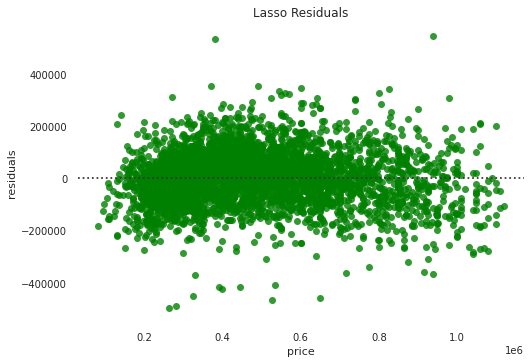

In [41]:
# plotting residuals
sb.residplot(y_test, y_pred, lowess=False, color="g", )
plt.xlabel('price')
plt.ylabel('residuals')
plt.title('Lasso Residuals')
plt.show()

In [42]:
# append coefficients
coeff_df3['Lasso Coefficients'] = lasso.coef_
coeff_df3

,Multiple Linear Coefficient,Ridge Coefficient,Lasso Coefficients
bedrooms,10030.028205,10062.721656,10003.226953
bathrooms,24970.591078,24975.328679,24948.164951
sqft_lot,9251.783927,9247.629853,9166.339084
floors,28039.744899,28005.278458,27615.264123
waterfront,7414.588505,7404.066570,7269.494329
view,24673.699785,24675.475968,24599.919961
condition,14844.506783,14854.808762,14730.879336
grade,117910.371708,117720.757062,117825.764894
sqft_basement,17493.303184,17490.760577,17294.693770
yr_built,-57610.683077,-57422.785214,-57115.418780


The regression coefficients are almost similar but lasso has slightly lower coefficients mainly because it applies stronger regularization.

### Elastic Net Regression

In [43]:
# assign features and target
X = housing_no_outliers.drop(['id', 'price', 'sqft_above', 'sqft_living', 'sqft_living15'], 1)
y = housing_no_outliers['price']

In [44]:
# scale the features
scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

In [45]:
# Dividing our data into training and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_std, y, test_size=0.2, random_state=0)

In [46]:
# Elastic net, just like ridge and lasso regression, requires normalize data.  
from sklearn.linear_model import ElasticNet

elastic=ElasticNet(normalize=True)
search=GridSearchCV(estimator=elastic,param_grid={'alpha':np.logspace(-10,5,16),'l1_ratio':[.1,.2,.3,.4,.5,.6,.7,.8,.9]},scoring='neg_mean_squared_error',n_jobs=1,refit=True,cv=10)

In [47]:
# train model and print best parameters
search.fit(X_train,y_train)
abs(search.best_score_)
print("elastic best parameters:", search.best_params_)

elastic best parameters: {'alpha': 1e-07, 'l1_ratio': 0.1}


In [48]:
# build elastic model with best parameters
elastic = ElasticNet(alpha=1e-07, l1_ratio=0.1, normalize=True)
elastic.fit(X_train, y_train)

print('Elastic model score:', elastic.score(X_test, y_test))
elastic_model_MSE = (mean_squared_error(y_true=y_test, y_pred=lasso.predict(X_test)))
print('Elastic model MSE:', elastic_model_MSE)

Elastic model score: 0.6629349737689408
Elastic model MSE: 14354712361.854296


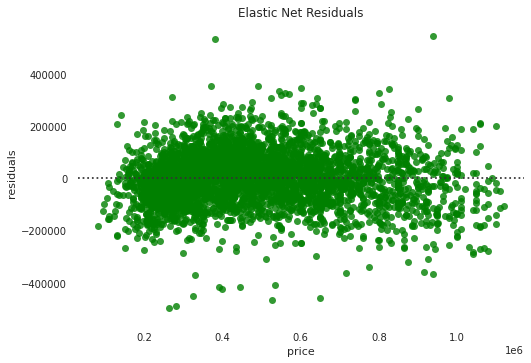

In [49]:
# plotting residuals
sb.residplot(y_test, y_pred, lowess=False, color="g", )
plt.xlabel('price')
plt.ylabel('residuals')
plt.title('Elastic Net Residuals')
plt.show()

In [50]:
# check coefficients
coeff_df3['Elastic Coefficients'] = elastic.coef_
coeff_df3

,Multiple Linear Coefficient,Ridge Coefficient,Lasso Coefficients,Elastic Coefficients
bedrooms,10030.028205,10062.721656,10003.226953,10078.129129
bathrooms,24970.591078,24975.328679,24948.164951,24977.577476
sqft_lot,9251.783927,9247.629853,9166.339084,9245.656659
floors,28039.744899,28005.278458,27615.264123,27989.024476
waterfront,7414.588505,7404.066570,7269.494329,7399.101214
view,24673.699785,24675.475968,24599.919961,24676.271851
condition,14844.506783,14854.808762,14730.879336,14859.609568
grade,117910.371708,117720.757062,117825.764894,117631.201643
sqft_basement,17493.303184,17490.760577,17294.693770,17489.567754
yr_built,-57610.683077,-57422.785214,-57115.418780,-57334.157518


Lets visualize the coefficients for the different models

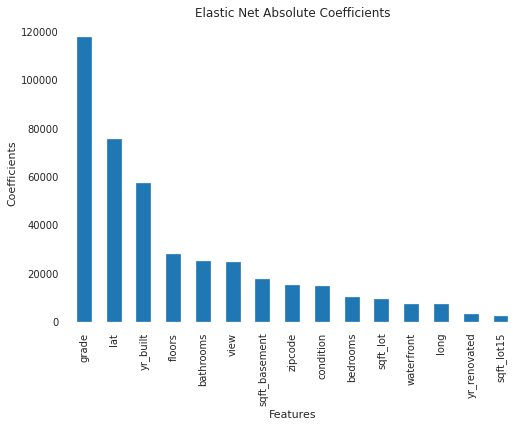

In [51]:
# bar plot for elastic net
absolute_coeffs = coeff_df3.abs()
absolute_coeffs['Elastic Coefficients'].sort_values(ascending=False).plot(kind='bar')
plt.xlabel('Features')
plt.ylabel('Coefficients')
plt.title('Elastic Net Absolute Coefficients')
plt.show()

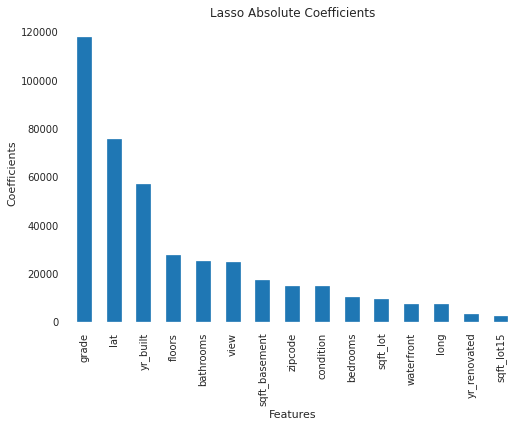

In [52]:
# bar plot for lasso
absolute_coeffs['Lasso Coefficients'].sort_values(ascending=False).plot(kind='bar')
plt.xlabel('Features')
plt.ylabel('Coefficients')
plt.title('Lasso Absolute Coefficients')
plt.show()

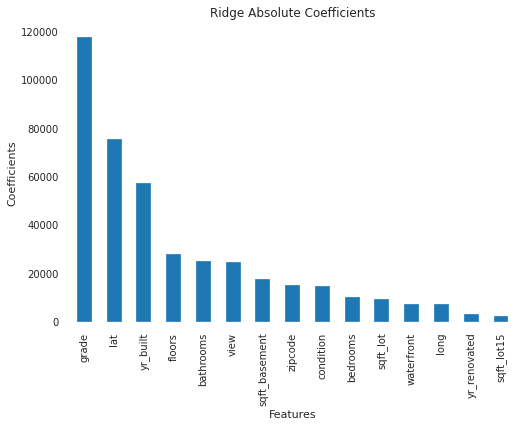

In [53]:
# bar plot for ridge
absolute_coeffs['Ridge Coefficient'].sort_values(ascending=False).plot(kind='bar')
plt.xlabel('Features')
plt.ylabel('Coefficients')
plt.title('Ridge Absolute Coefficients')
plt.show()

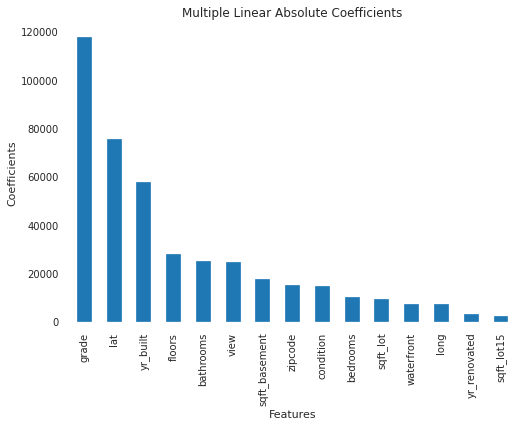

In [54]:
# bar plot for multiple_linear
absolute_coeffs['Multiple Linear Coefficient'].sort_values(ascending=False).plot(kind='bar')
plt.xlabel('Features')
plt.ylabel('Coefficients')
plt.title('Multiple Linear Absolute Coefficients')
plt.show()

### Quantile Regression

Rather than making predictions, I will use the quantile regression to examine the effect of the different features on the target across differnt quantiles to compare the cheap versus expensive houses. A major justification for quantile regressions is when the residuals and the fitted target values have unequal variances. To check this, I will use levene's test for equality of variance.

In [55]:
# perform variance test
from scipy.stats import levene

residuals = y_test - y_pred
stat, p1 = levene(y_test, residuals)
print('p-value:', round(p1, 4))

p-value: 0.0


At a significance level of 95%, the homoskedesticity test indicates that the variances are significantly different, hence quantile regression can be applied.

In [56]:
# assign the target and features
X1, X2, X3, X4, X5, X6, X7, X8, X9 = housing['grade'], housing['lat'], housing['yr_built'], housing['floors'], housing['bathrooms'], housing['view'], housing['sqft_basement'], housing['zipcode'], housing['condition']
y = housing['price']

In [57]:
# Defining function for quantile parameters
def quantile_params(mod, X):
  # defining quantiles
  quantiles = np.arange(0.1,1,0.1) 
  params = []
  models = []

  # We build models for each quantile in our list quantiles inside a for loop
  # As we build these models we also store the model parameters in a list called params. 
  for qt in quantiles: 
	  res = mod.fit(q = qt )
	  models.append(res)
	  params.append([qt, res.params['Intercept'], res.params[X]] + res.conf_int().loc[X].tolist())

  # Lastly we make a dataframe of the same name, so we we can view our different models.
  params = pd.DataFrame(data = params, columns = ['qt', 'intercept', 'x_coef', 'cf_lower_bound', 'cf_upper_bound'])
  return params

I have defined a function that returns computes the intercept, coefficient of X along with its upper and lower bounds which I will use to plot the slopes of the different coefficients.

In [58]:
import statsmodels.formula.api as smf
# Finding the latitude regression coefficients for the selected quantiles
mod = smf.quantreg('y ~ X1', housing)
params_grade = quantile_params(mod = mod, X='X1')

# Finding the grade regression coefficients for the selected quantiles
mod = smf.quantreg('y ~ X2', housing)
params_lat = quantile_params(mod = mod, X='X2')

# Finding the sqft_living regression coefficients for the 0selected quantiles
mod = smf.quantreg('y ~ X3', housing)
params_yr_built = quantile_params(mod = mod, X='X3')

# Finding the year built regression coefficients for the selected quantiles
mod = smf.quantreg('y ~ X4', housing)
params_floors = quantile_params(mod = mod, X='X4')

# Finding the sqft_living15 regression coefficients for the selected quantiles
mod = smf.quantreg('y ~ X5', housing)
params_bathrooms = quantile_params(mod = mod, X='X5')

# Finding the view regression coefficients for the selected quantiles
mod = smf.quantreg('y ~ X6', housing)
params_view = quantile_params(mod = mod, X='X6')

# Finding the floors regression coefficients for the selected quantiles
mod = smf.quantreg('y ~ X7', housing)
params_basement = quantile_params(mod = mod, X='X7')

# Finding the condition regression coefficients for the 0selected quantiles
mod = smf.quantreg('y ~ X8', housing)
params_zipcode = quantile_params(mod = mod, X='X8')

# Finding the bathrooms regression coefficients for the selected quantiles
mod = smf.quantreg('y ~ X9', housing)
params_condition = quantile_params(mod = mod, X='X9')

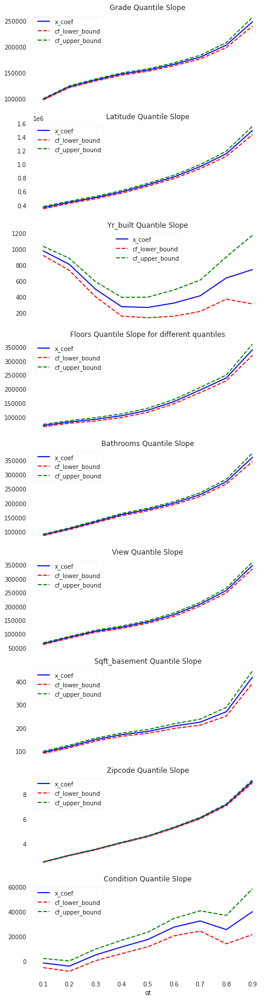

In [59]:
# plot feature coefficients
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9) = plt.subplots(nrows=9, ncols=1, sharex=True, figsize=(7,30))
params_grade.plot(x = 'qt', y = ['x_coef','cf_lower_bound', 'cf_upper_bound'], 
	title = 'Grade Quantile Slope', kind ='line', style = ['b-','r--','g--'], ax=ax1)
params_lat.plot(x = 'qt', y = ['x_coef','cf_lower_bound', 'cf_upper_bound'], 
	title = 'Latitude Quantile Slope', kind ='line', style = ['b-','r--','g--'], ax=ax2)
params_yr_built.plot(x = 'qt', y = ['x_coef','cf_lower_bound', 'cf_upper_bound'], 
	title = 'Yr_built Quantile Slope', kind ='line', style = ['b-','r--','g--'], ax=ax3)
params_floors.plot(x = 'qt', y = ['x_coef','cf_lower_bound', 'cf_upper_bound'], 
	title = 'Floors Quantile Slope for different quantiles', kind ='line', style = ['b-','r--','g--'], ax=ax4)
params_bathrooms.plot(x = 'qt', y = ['x_coef','cf_lower_bound', 'cf_upper_bound'], 
	title = 'Bathrooms Quantile Slope', kind ='line', style = ['b-','r--','g--'], ax=ax5)
params_view.plot(x = 'qt', y = ['x_coef','cf_lower_bound', 'cf_upper_bound'], 
	title = 'View Quantile Slope', kind ='line', style = ['b-','r--','g--'], ax=ax6)
params_basement.plot(x = 'qt', y = ['x_coef','cf_lower_bound', 'cf_upper_bound'], 
	title = 'Sqft_basement Quantile Slope', kind ='line', style = ['b-','r--','g--'], ax=ax7)
params_zipcode.plot(x = 'qt', y = ['x_coef','cf_lower_bound', 'cf_upper_bound'], 
	title = 'Zipcode Quantile Slope', kind ='line', style = ['b-','r--','g--'], ax=ax8)
params_condition.plot(x = 'qt', y = ['x_coef','cf_lower_bound', 'cf_upper_bound'], 
	title = 'Condition Quantile Slope', kind ='line', style = ['b-','r--','g--'], ax=ax9)
plt.show()

In [60]:
# assigning the target and features
X = housing_no_outliers[['grade', 'lat', 'yr_built', 'floors', 'bathrooms', 'view', 'sqft_basement', 'zipcode',  'condition', 'bedrooms', 'sqft_lot', 'waterfront', 'long', 'yr_renovated', 'sqft_lot15']]
y = housing_no_outliers['price']

We fit regression models at different quantiles and observe model performance using the r-squared.

In [62]:
# import smf
import statsmodels.formula.api as smf

# Finding the regression coefficients for the conditioned median, 0.5 quantile
mod = smf.quantreg('y ~ X', housing_no_outliers, )
res = mod.fit(q=.5)

# check model summary
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                         QuantReg Regression Results                          
==============================================================================
Dep. Variable:                      y   Pseudo R-squared:               0.4444
Model:                       QuantReg   Bandwidth:                   1.909e+04
Method:                 Least Squares   Sparsity:                    2.583e+05
Date:                Mon, 03 Aug 2020   No. Observations:                20471
Time:                        15:56:45   Df Residuals:                    20455
                                        Df Model:                           15
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    -51.9916      2.686    -19.355      0.000     -57.257     -46.727
X[0]        1.089e+05   1167.366     93.266      0.000    1.07e+05    1.11e+05
X[1]         5.12e+05   6943.910     73.736      0.000    4.98e+05    5.26e+05
X[2]       -1903.4412     44.204    -43.060      0.000   -1990.086   -1816.797
X[3]        5.845e+04   2242.595     26.063      0.000    5.41e+04    6.28e+04
X[4]        3.799e+04   1818.844     20.887      0.000    3.44e+04    4.16e+04
X[5]         4.15e+04   1541.652     26.921      0.000    3.85e+04    4.45e+04
X[6]          38.1598      2.721     14.025      0.000      32.827      43.493
X[7]        -104.2041     11.381     -9.156      0.000    -126.512     -81.897
X[8]        1.964e+04   1534.234     12.801      0.000    1.66e+04    2.26e+04
X[9]        9465.1414   1155.924      8.188      0.000    7199.437    1.17e+04
X[10]          0.3114      0.032      9.691      0.000       0.248       0.374
X[11]       1.022e+05   1.74e+04      5.866      0.000     6.8e+04    1.36e+05
X[12]       9.015e+04   8295.193     10.868      0.000    7.39e+04    1.06e+05
X[13]         11.3121      2.523      4.483      0.000       6.366      16.258
X[14]          0.0721      0.049      1.475      0.140      -0.024       0.168
==============================================================================

The condition number is large, 2.1e+08. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [63]:
# Finding the regression coefficients for the 0.1 quantile
#
mod = smf.quantreg('y ~ X', housing_no_outliers)
res = mod.fit(q=.1)

# check model summary
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                         QuantReg Regression Results                          
==============================================================================
Dep. Variable:                      y   Pseudo R-squared:               0.3550
Model:                       QuantReg   Bandwidth:                   1.787e+04
Method:                 Least Squares   Sparsity:                    4.159e+05
Date:                Mon, 03 Aug 2020   No. Observations:                20471
Time:                        15:59:43   Df Residuals:                    20455
                                        Df Model:                           15
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     31.8218      2.924     10.883      0.000      26.091      37.553
X[0]        8.222e+04   1110.112     74.069      0.000       8e+04    8.44e+04
X[1]         3.55e+05   8250.272     43.023      0.000    3.39e+05    3.71e+05
X[2]        -759.0886     39.742    -19.101      0.000    -836.986    -681.192
X[3]        2.067e+04   2494.856      8.285      0.000    1.58e+04    2.56e+04
X[4]        2.596e+04   1895.368     13.695      0.000    2.22e+04    2.97e+04
X[5]        2.819e+04   1512.703     18.635      0.000    2.52e+04    3.12e+04
X[6]          24.6779      2.703      9.129      0.000      19.379      29.976
X[7]         -64.7838     12.905     -5.020      0.000     -90.079     -39.488
X[8]        1.799e+04   1544.730     11.644      0.000     1.5e+04     2.1e+04
X[9]        1.006e+04   1470.062      6.844      0.000    7179.246    1.29e+04
X[10]          0.1603      0.042      3.790      0.000       0.077       0.243
X[11]       7.939e+04   1.66e+04      4.780      0.000    4.68e+04    1.12e+05
X[12]       7.777e+04   9640.055      8.068      0.000    5.89e+04    9.67e+04
X[13]          7.5537      2.457      3.074      0.002       2.738      12.370
X[14]          0.0607      0.061      0.997      0.319      -0.059       0.180
==============================================================================

The condition number is large, 2.1e+08. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [65]:
# Finding the regression coefficients for the 0.8 quantile
mod = smf.quantreg('y ~ X', housing_no_outliers)
res = mod.fit(q=.8)

# Then print out the summary of our model
#
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                         QuantReg Regression Results                          
==============================================================================
Dep. Variable:                      y   Pseudo R-squared:               0.4640
Model:                       QuantReg   Bandwidth:                   1.640e+04
Method:                 Least Squares   Sparsity:                    4.607e+05
Date:                Mon, 03 Aug 2020   No. Observations:                20471
Time:                        16:02:49   Df Residuals:                    20455
                                        Df Model:                           15
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   -169.6771      3.879    -43.746      0.000    -177.280    -162.074
X[0]        1.197e+05   1811.495     66.053      0.000    1.16e+05    1.23e+05
X[1]        6.091e+05   8495.476     71.693      0.000    5.92e+05    6.26e+05
X[2]       -2124.1219     66.812    -31.793      0.000   -2255.079   -1993.165
X[3]        6.022e+04   3110.925     19.356      0.000    5.41e+04    6.63e+04
X[4]        3.954e+04   2643.918     14.956      0.000    3.44e+04    4.47e+04
X[5]        4.698e+04   2202.123     21.336      0.000    4.27e+04    5.13e+04
X[6]          54.4920      3.988     13.663      0.000      46.674      62.310
X[7]        -183.5449     15.611    -11.757      0.000    -214.144    -152.946
X[8]        2.134e+04   2227.992      9.578      0.000     1.7e+04    2.57e+04
X[9]         1.46e+04   1616.837      9.033      0.000    1.14e+04    1.78e+04
X[10]          0.3704      0.037     10.048      0.000       0.298       0.443
X[11]       1.587e+05   2.54e+04      6.258      0.000    1.09e+05    2.08e+05
X[12]       6.081e+04   1.15e+04      5.296      0.000    3.83e+04    8.33e+04
X[13]         18.0069      3.661      4.919      0.000      10.831      25.182
X[14]          0.0824      0.064      1.290      0.197      -0.043       0.207
==============================================================================

The condition number is large, 2.1e+08. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

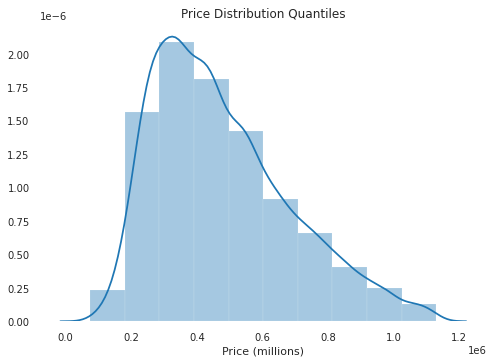

In [66]:
# Visualize quantiles for price distribution
sb.distplot(housing_no_outliers['price'], bins=10, hist=True)
plt.title('Price Distribution Quantiles')
plt.xlabel('Price (millions)')
plt.show()

To test the quantile regression models, I will predict the price of a house at 0.1 and o.8 quantiles.I will bin the data set using the price column.

In [69]:
# Define quantiles 
housing_no_outliers['Quantiles'] = pd.cut(housing_no_outliers['price'], bins=10)
housing_no_outliers['Quantiles'] = housing_no_outliers['Quantiles'].astype(str)

# Get required quantiles for prediction
lower_quantile = housing_no_outliers.groupby(by='Quantiles', axis=0).get_group('(73945.0, 180500.0]')
upper_quantile = housing_no_outliers.groupby(by='Quantiles', axis=0).get_group('(919000.0, 1024500.0]')

print('lower quantile:', lower_quantile.shape)
print('upper quantile:', upper_quantile.shape)

lower quantile: (504, 21)
upper quantile: (530, 21)


In [79]:
# rename columns
lower_q = lower_quantile[['id', 'price', 'grade', 'lat', 'yr_built', 'floors', 'bathrooms', 'view', 'sqft_basement', 'zipcode',  'condition', 'bedrooms', 'sqft_lot', 'waterfront', 'long', 'yr_renovated', 'sqft_lot15']]
lower_q.columns = ['id', 'price', 'X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X7', 'X8', 'X9', 'X10', 'X11', 'X12', 'X13', 'X14' 'X15']

upper_q = upper_quantile[['id', 'price', 'grade', 'lat', 'yr_built', 'floors', 'bathrooms', 'view', 'sqft_basement', 'zipcode',  'condition', 'bedrooms', 'sqft_lot', 'waterfront', 'long', 'yr_renovated', 'sqft_lot15']]
upper_q.columns = ['id', 'price', 'X0' 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X7', 'X8', 'X9', 'X10', 'X11', 'X12', 'X13', 'X14', 'X15']

#### Quantile regression formula:

y = B0(q) + B1(q)X1 + B2(q)X2 ....Bn(q)Xn

where q is the quantile and B(q) is the beta coefficient of X at the respective quantiles.

In [88]:
# make predictions for expensive houses
upper_y_pred = []
for index, row in upper_q.iterrows():
  X0, X1, X2, X3, X4, X5, X6, X7, X8, X9, X10, X11, X12, X13, X14 = row[2], row[3], row[4], row[5], row[6], row[7], row[8], row[9], row[10], row[11], row[12], row[13], row[14], row[15], row[16]
  y_pred = -169.6771 + (1.197e+05 * X0) + (6.091e+05 * X1) + (-2124.1219 * X2) + (6.022e+04 * X3) + (3.954e+04 * X4) + (4.698e+04 * X5) + (54.4920 * X6) + (-183.5449 * X7) + (2.134e+04 * X8) + (1.46e+04 * X9) + (0.3704 * X10) + (1.587e+05 * X11) + (6.081e+04 * X12) + (18.0069 * X13) + (0.0824 * X14)
  upper_y_pred.append(round(y_pred, 3))

upper_q['price predictions'] = upper_y_pred
upper_price_pred = upper_q[['price', 'price predictions']]
expensive_MSE =  mean_squared_error(upper_q['price'], upper_q['price predictions'])
print('MSE for expensive houses:', expensive_MSE)

MSE for expensive houses: 28468489415.22211


In [90]:
# make predictions for cheap houses
lower_y_pred = []
for index, row in lower_q.iterrows():
  X0, X1, X2, X3, X4, X5, X6, X7, X8, X9, X10, X11, X12, X13, X14 = row[2], row[3], row[4], row[5], row[6], row[7], row[8], row[9], row[10], row[11], row[12], row[13], row[14], row[15], row[16]
  y_pred = 31.8218 + (8.222e+04 * X0) + (3.55e+05 * X1) + (-759.0886 * X2) + (2.067e+04 * X3) + (2.596e+04 * X4) + (2.819e+04 * X5) + (24.6779 * X6) + (-64.7838 * X7) + (1.799e+04 * X8) + (1.006e+04 * X9) + (0.1603 * X10) + (7.939e+04 * X11) + (7.777e+04 * X12) + (7.5537 * X13) + (0.0607 * X14)
  lower_y_pred.append(round(y_pred, 3))

lower_q['price predictions'] = lower_y_pred
lower_price_pred = upper_q[['price', 'price predictions']]
cheap_MSE =  mean_squared_error(lower_q['price'], lower_q['price predictions'])
print('MSE for cheap houses:', cheap_MSE)

MSE for cheap houses: 5182795836.448989


From the price distribution plot, it is clear that price is positively skewed and this explains why the quantile regression model performs better at predicting the price of 'cheaper' houses compared to the more expensive ones. The residual plot also indicated unequal variance which further explains our model's behavior. 

## Summary and Recommendations

In this project, I was tasked with creating a regression model that can predict the price of a house given certain variable conditions. I created five regression models namely multiple linear, ridge, lasso, and elastic net regressions. I used the first four models to predict the price of houses and they all had a score of 66% with small differences in their mean squared errors. The features with the greatest impact on the price of a house are 'grade', 'lat', 'yr_built', 'floors', 'bathrooms', and 'view' which the highest absolute values.

With regards to the quantile regression model, I used it to examine the impact of different variables on the price of a 'cheap' house versus and 'expensive' house. For each of the six features mentioned earlier aside from 'yr_built', the variable coefficients have a relatvively smaller impact on the price of a 'cheap' house compared to an 'expensive' house. Although their is huge variation in the coefficient confidence intervals for the 'yr_built', its effect is almost similar across quantiles. However, it is important to note that 'yr_built' has a bigger impact on the price of 'cheap' houses compared to 'average' houses.

Due to the inequality of variances, I would recommend the use of quantile regressions to make predictions for the price of houses. However, it is important to note that the model has smaller errors predicting cheap houses compared to the expensive ones.

## Challenging the result

A major challenge I encountered during this project was predicting the price of houses for differnt quantiles. The statsmodels package for quantile regression only supports a handful of features so I struggled to compute the coefficients of all features. As a work around this, I used the features that best predict price which decreased accuracy relative to earlier models I created.

To improve the score, I will look to add new features while also performing k-fold cross-validation.